## Goals for this session
- [x] review bug reports:
  - [x] https://github.com/duckdb/duckdb/issues/7015
  - [x] https://github.com/zulip/zulip/issues/25152 --> redirect here: https://zulip.com/development-community/
  - [x] https://github.com/ploomber/jupysql/issues/409
- [x] load data in duckdb
- [x] save data to parquet
  - [x] did not work in duckdb
  - [x] worked using pandas
- [x] visualize data in altair
- [x] maybe visualize data on a map
- [ ] maybe visualize data using falcon

In [1]:
# smallest possible test case for SQL query using jupyter notebook cell magic commands
import duckdb
import pandas as pd

# Import jupysql Jupyter extension to create SQL cells
%load_ext sql

# Set configrations on jupysql to directly output data to Pandas and to simplify the output that is printed to the notebook.
%config SqlMagic.autopandas = True
%config SqlMagic.feedback = False
%config SqlMagic.displaycon = False

# Connect jupysql to DuckDB using a SQLAlchemy-style connection string. Either connect to an in memory DuckDB, or a file backed db.
%sql duckdb:///:memory:

In [2]:
%%sql
SELECT *
FROM read_csv('/Users/me/Downloads/311_Service_Requests_from_2010_to_Present.csv',
    header=True,
    delim=',',
    quote='"',
    columns={'Unique Key': 'BIGINT', 'Created Date': 'VARCHAR', 'Closed Date': 'VARCHAR', 'Agency': 'VARCHAR', 'Agency Name': 'VARCHAR', 'Complaint Type': 'VARCHAR', 'Descriptor': 'VARCHAR', 'Location Type': 'VARCHAR', 'Incident Zip': 'VARCHAR', 'Incident Address': 'VARCHAR', 'Street Name': 'VARCHAR', 'Cross Street 1': 'VARCHAR', 'Cross Street 2': 'VARCHAR', 'Intersection Street 1': 'VARCHAR', 'Intersection Street 2': 'VARCHAR', 'Address Type': 'VARCHAR', 'City': 'VARCHAR', 'Landmark': 'VARCHAR', 'Facility Type': 'VARCHAR', 'Status': 'VARCHAR', 'Due Date': 'VARCHAR', 'Resolution Description': 'VARCHAR', 'Resolution Action Updated Date': 'VARCHAR', 'Community Board': 'VARCHAR', 'BBL': 'VARCHAR', 'Borough': 'VARCHAR', 'X Coordinate (State Plane)': 'VARCHAR', 'Y Coordinate (State Plane)': 'VARCHAR', 'Open Data Channel Type': 'VARCHAR', 'Park Facility Name': 'VARCHAR', 'Park Borough': 'VARCHAR', 'Vehicle Type': 'VARCHAR', 'Taxi Company Borough': 'VARCHAR', 'Taxi Pick Up Location': 'VARCHAR', 'Bridge Highway Name': 'VARCHAR', 'Bridge Highway Direction': 'VARCHAR', 'Road Ramp': 'VARCHAR', 'Bridge Highway Segment': 'VARCHAR', 'Latitude': 'DOUBLE', 'Longitude': 'DOUBLE', 'Location': 'VARCHAR'}) 
LIMIT 1000000;

,Unique Key,Created Date,Closed Date,Agency,Agency Name,Complaint Type,Descriptor,Location Type,Incident Zip,Incident Address,...,Vehicle Type,Taxi Company Borough,Taxi Pick Up Location,Bridge Highway Name,Bridge Highway Direction,Road Ramp,Bridge Highway Segment,Latitude,Longitude,Location
0,34247134,09/04/2016 02:35:29 PM,09/07/2016 03:50:31 PM,DPR,Department of Parks and Recreation,Maintenance or Facility,Hours of Operation,Beach,11235,None,...,None,None,None,None,None,None,None,NaN,NaN,None
1,34250114,09/05/2016 03:47:42 PM,09/07/2016 03:47:11 PM,DOF,Land Records,DOF Property - Update Account,Billing Name Incorrect,Property Address,11224,None,...,None,None,None,None,None,None,None,NaN,NaN,None
2,34249970,09/05/2016 03:56:00 PM,09/12/2016 10:06:25 AM,DPR,Department of Parks and Recreation,Maintenance or Facility,Structure - Indoors,Park,10027,None,...,None,None,None,None,None,None,None,NaN,NaN,None
3,27050693,01/04/2014 02:10:00 PM,01/20/2014 09:50:00 AM,DOT,Department of Transportation,Traffic Signal Condition,LED Lense,None,None,None,...,None,None,None,None,None,None,None,NaN,NaN,None
4,34262636,09/07/2016 09:49:51 AM,09/15/2016 07:00:28 PM,DOF,Refunds and Adjustments,DOF Property - Payment Issue,Property Refunds and Credits,Property Address,10014,None,...,None,None,None,None,None,None,None,NaN,NaN,None
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
999995,16901519,06/19/2010 05:27:00 PM,06/19/2010 07:35:00 PM,DEP,Department of Environmental Protection,Sewer,Manhole Cover Missing (Emergency) (SA3),None,10022,306 EAST 59 STREET,...,None,None,None,None,None,None,None,40.760411,-73.963888,"(40.76041100049983, -73.96388833030763)"
999996,16901520,06/19/2010 05:23:00 PM,06/20/2010 03:55:00 AM,DEP,Department of Environmental Protection,Water System,Hydrant Running Full (WA4),None,10451,710 CONCOURSE VILLAGE WEST,...,None,None,None,None,None,None,None,40.821950,-73.924043,"(40.82195046118972, -73.92404260527317)"
999997,16901521,06/19/2010 05:08:00 PM,06/19/2010 05:09:00 PM,DEP,Department of Environmental Protection,Water System,Hydrant Running (WC3),None,11367,61-52 149 STREET,...,None,None,None,None,None,None,None,40.739645,-73.820537,"(40.739644564631654, -73.82053708356474)"
999998,16901522,06/19/2010 05:31:00 PM,07/14/2010 12:33:00 PM,DEP,Department of Environmental Protection,Air Quality,"Air: Odor/Fumes, Restaurant (AD2)",None,10036,596 10 AVENUE,...,None,None,None,None,None,None,None,40.760392,-73.994903,"(40.76039184487642, -73.99490307261837)"


In [3]:
df = _

## Used Bard which seemed faster with the following query

```
hi gpt-4! can you please rewrite this SQL query using duckdb in python: 

CREATE TABLE service_requests AS 
SELECT *
FROM read_csv('/Users/me/Downloads/311_Service_Requests_from_2010_to_Present.csv',
    header=True,
    delim=',',
    quote='"',
    columns={'Unique Key': 'BIGINT', 'Created Date': 'VARCHAR', 'Closed Date': 'VARCHAR', 'Agency': 'VARCHAR', 'Agency Name': 'VARCHAR', 'Complaint Type': 'VARCHAR', 'Descriptor': 'VARCHAR', 'Location Type': 'VARCHAR', 'Incident Zip': 'VARCHAR', 'Incident Address': 'VARCHAR', 'Street Name': 'VARCHAR', 'Cross Street 1': 'VARCHAR', 'Cross Street 2': 'VARCHAR', 'Intersection Street 1': 'VARCHAR', 'Intersection Street 2': 'VARCHAR', 'Address Type': 'VARCHAR', 'City': 'VARCHAR', 'Landmark': 'VARCHAR', 'Facility Type': 'VARCHAR', 'Status': 'VARCHAR', 'Due Date': 'VARCHAR', 'Resolution Description': 'VARCHAR', 'Resolution Action Updated Date': 'VARCHAR', 'Community Board': 'VARCHAR', 'BBL': 'VARCHAR', 'Borough': 'VARCHAR', 'X Coordinate (State Plane)': 'VARCHAR', 'Y Coordinate (State Plane)': 'VARCHAR', 'Open Data Channel Type': 'VARCHAR', 'Park Facility Name': 'VARCHAR', 'Park Borough': 'VARCHAR', 'Vehicle Type': 'VARCHAR', 'Taxi Company Borough': 'VARCHAR', 'Taxi Pick Up Location': 'VARCHAR', 'Bridge Highway Name': 'VARCHAR', 'Bridge Highway Direction': 'VARCHAR', 'Road Ramp': 'VARCHAR', 'Bridge Highway Segment': 'VARCHAR', 'Latitude': 'DOUBLE', 'Longitude': 'DOUBLE', 'Location': 'VARCHAR'}) 
```
Then: please rewrite this to save the output as a parquet file.

In [5]:
import duckdb

# Create a connection to DuckDB
conn = duckdb.connect()

# Create a table from the CSV file
with open('/Users/me/Downloads/311_Service_Requests_from_2010_to_Present.csv', 'r') as f:
  conn.create_table('service_requests', f, header=True, delimiter=',', quote='"', columns={
    'Unique Key': 'BIGINT', 
    'Created Date': 'VARCHAR', 
    'Closed Date': 'VARCHAR', 
    'Agency': 'VARCHAR', 
    'Agency Name': 'VARCHAR', 
    'Complaint Type': 'VARCHAR', 
    'Descriptor': 'VARCHAR', 
    'Location Type': 'VARCHAR', 
    'Incident Zip': 'VARCHAR', 
    'Incident Address': 'VARCHAR', 
    'Street Name': 'VARCHAR', 
    'Cross Street 1': 'VARCHAR', 
    'Cross Street 2': 'VARCHAR', 
    'Intersection Street 1': 'VARCHAR', 
    'Intersection Street 2': 'VARCHAR', 
    'Address Type': 'VARCHAR', 
    'City': 'VARCHAR', 
    'Landmark': 'VARCHAR', 
    'Facility Type': 'VARCHAR', 
    'Status': 'VARCHAR', 
    'Due Date': 'VARCHAR', 
    'Resolution Description': 'VARCHAR', 
    'Resolution Action Updated Date': 'VARCHAR', 
    'Community Board': 'VARCHAR', 
    'BBL': 'VARCHAR', 
    'Borough': 'VARCHAR', 
    'X Coordinate (State Plane)': 'VARCHAR', 
    'Y Coordinate (State Plane)': 'VARCHAR', 
    'Open Data Channel Type': 'VARCHAR', 
    'Park Facility Name': 'VARCHAR', 
    'Park Borough': 'VARCHAR', 
    'Vehicle Type': 'VARCHAR', 
    'Taxi Company Borough': 'VARCHAR', 
    'Taxi Pick Up Location': 'VARCHAR', 
    'Bridge Highway Name': 'VARCHAR', 
    'Bridge Highway Direction': 'VARCHAR', 
    'Road Ramp': 'VARCHAR', 
    'Bridge Highway Segment': 'VARCHAR', 
    'Latitude': 'DOUBLE', 
    'Longitude': 'DOUBLE', 
    'Location': 'VARCHAR'})

# Write the table to a Parquet file
conn.copy('service_requests', '/Users/me/Downloads/service_requests.parquet', format='PARQUET')

# Close the connection
conn.close()

AttributeError: 'duckdb.DuckDBPyConnection' object has no attribute 'create_table'

## BARD IS FAST BUT WRONG!

In [6]:
import duckdb

# Create a connection to the in-memory DuckDB database
conn = duckdb.connect(':memory:')

# Read CSV into a DuckDB table
csv_file = '/Users/me/Downloads/311_Service_Requests_from_2010_to_Present.csv'
csv_columns = {
    'Unique Key': 'BIGINT', 
    'Created Date': 'VARCHAR', 
    'Closed Date': 'VARCHAR', 
    'Agency': 'VARCHAR', 
    'Agency Name': 'VARCHAR', 
    'Complaint Type': 'VARCHAR', 
    'Descriptor': 'VARCHAR', 
    'Location Type': 'VARCHAR', 
    'Incident Zip': 'VARCHAR', 
    'Incident Address': 'VARCHAR', 
    'Street Name': 'VARCHAR', 
    'Cross Street 1': 'VARCHAR', 
    'Cross Street 2': 'VARCHAR', 
    'Intersection Street 1': 'VARCHAR', 
    'Intersection Street 2': 'VARCHAR', 
    'Address Type': 'VARCHAR', 
    'City': 'VARCHAR', 
    'Landmark': 'VARCHAR', 
    'Facility Type': 'VARCHAR', 
    'Status': 'VARCHAR', 
    'Due Date': 'VARCHAR', 
    'Resolution Description': 'VARCHAR', 
    'Resolution Action Updated Date': 'VARCHAR', 
    'Community Board': 'VARCHAR', 
    'BBL': 'VARCHAR', 
    'Borough': 'VARCHAR', 
    'X Coordinate (State Plane)': 'VARCHAR', 
    'Y Coordinate (State Plane)': 'VARCHAR', 
    'Open Data Channel Type': 'VARCHAR', 
    'Park Facility Name': 'VARCHAR', 
    'Park Borough': 'VARCHAR', 
    'Vehicle Type': 'VARCHAR', 
    'Taxi Company Borough': 'VARCHAR', 
    'Taxi Pick Up Location': 'VARCHAR', 
    'Bridge Highway Name': 'VARCHAR', 
    'Bridge Highway Direction': 'VARCHAR', 
    'Road Ramp': 'VARCHAR', 
    'Bridge Highway Segment': 'VARCHAR', 
    'Latitude': 'DOUBLE', 
    'Longitude': 'DOUBLE', 
    'Location': 'VARCHAR'
}

df = duckdb.read_csv(csv_file, sep=',', quotechar='"', columns=csv_columns)

# Create a new table and insert the DataFrame
conn.register('service_requests', df)

# Now you can run queries on the 'service_requests' table
result = conn.execute('SELECT * FROM service_requests').fetchall()
print(result)


TypeError: read_csv(): incompatible function arguments. The following argument types are supported:
    1. (name: str, connection: duckdb.DuckDBPyConnection = None, header: object = None, compression: object = None, sep: object = None, delimiter: object = None, dtype: object = None, na_values: object = None, skiprows: object = None, quotechar: object = None, escapechar: object = None, encoding: object = None, parallel: object = None, date_format: object = None, timestamp_format: object = None, sample_size: object = None, all_varchar: object = None, normalize_names: object = None, filename: object = None) -> duckdb.DuckDBPyRelation

Invoked with: '/Users/me/Downloads/311_Service_Requests_from_2010_to_Present.csv'; kwargs: sep=',', quotechar='"', columns={'Unique Key': 'BIGINT', 'Created Date': 'VARCHAR', 'Closed Date': 'VARCHAR', 'Agency': 'VARCHAR', 'Agency Name': 'VARCHAR', 'Complaint Type': 'VARCHAR', 'Descriptor': 'VARCHAR', 'Location Type': 'VARCHAR', 'Incident Zip': 'VARCHAR', 'Incident Address': 'VARCHAR', 'Street Name': 'VARCHAR', 'Cross Street 1': 'VARCHAR', 'Cross Street 2': 'VARCHAR', 'Intersection Street 1': 'VARCHAR', 'Intersection Street 2': 'VARCHAR', 'Address Type': 'VARCHAR', 'City': 'VARCHAR', 'Landmark': 'VARCHAR', 'Facility Type': 'VARCHAR', 'Status': 'VARCHAR', 'Due Date': 'VARCHAR', 'Resolution Description': 'VARCHAR', 'Resolution Action Updated Date': 'VARCHAR', 'Community Board': 'VARCHAR', 'BBL': 'VARCHAR', 'Borough': 'VARCHAR', 'X Coordinate (State Plane)': 'VARCHAR', 'Y Coordinate (State Plane)': 'VARCHAR', 'Open Data Channel Type': 'VARCHAR', 'Park Facility Name': 'VARCHAR', 'Park Borough': 'VARCHAR', 'Vehicle Type': 'VARCHAR', 'Taxi Company Borough': 'VARCHAR', 'Taxi Pick Up Location': 'VARCHAR', 'Bridge Highway Name': 'VARCHAR', 'Bridge Highway Direction': 'VARCHAR', 'Road Ramp': 'VARCHAR', 'Bridge Highway Segment': 'VARCHAR', 'Latitude': 'DOUBLE', 'Longitude': 'DOUBLE', 'Location': 'VARCHAR'}

## GPT-4 also doesn't work out of the box

 Here is the query rewritten to save the CSV as a Parquet file instead:
```python
import duckdb

conn = duckdb.connect()

conn.execute("CREATE TABLE service_requests AS SELECT * FROM read_csv('/Users/me/Downloads/311_Service_Requests_from_2010_to_Present.csv', header=True, delim=',', quote='\"', columns={'Unique Key': 'BIGINT', 'Created Date': 'VARCHAR', 'Closed Date': 'VARCHAR', 'Agency': 'VARCHAR', 'Agency Name': 'VARCHAR', 'Complaint Type': 'VARCHAR', 'Descriptor': 'VARCHAR', 'Location Type': 'VARCHAR', 'Incident Zip': 'VARCHAR', 'Incident Address': 'VARCHAR', 'Street Name': 'VARCHAR', 'Cross Street 1': 'VARCHAR', 'Cross Street 2': 'VARCHAR', 'Intersection Street 1': 'VARCHAR', 'Intersection Street 2': 'VARCHAR', 'Address Type': 'VARCHAR', 'City': 'VARCHAR', 'Landmark': 'VARCHAR', 'Facility Type': 'VARCHAR', 'Status': 'VARCHAR', 'Due Date': 'VARCHAR', 'Resolution Description': 'VARCHAR', 'Resolution Action Updated Date': 'VARCHAR', 'Community Board': 'VARCHAR', 'BBL': 'VARCHAR', 'Borough': 'VARCHAR', 'X Coordinate (State Plane)': 'VARCHAR', 'Y Coordinate (State Plane)': 'VARCHAR', 'Open Data Channel Type': 'VARCHAR', 'Park Facility Name': 'VARCHAR', 'Park Borough': 'VARCHAR', 'Vehicle Type': 'VARCHAR', 'Taxi Company Borough': 'VARCHAR', 'Taxi Pick Up Location': 'VARCHAR', 'Bridge Highway Name': 'VARCHAR', 'Bridge Highway Direction': 'VARCHAR', 'Road Ramp': 'VARCHAR', 'Bridge Highway Segment': 'VARCHAR', 'Latitude': 'DOUBLE', 'Longitude': 'DOUBLE', 'Location': 'VARCHAR'})")

conn.execute("COPY service_requests TO '/Users/me/service_requests.parquet' (FORMAT 'parquet')")
```

This will first create the `service_requests` table from the CSV, and then export the contents of that table to a Parquet file called `service_requests.parquet`.

In [7]:
import duckdb

conn = duckdb.connect()

conn.execute("CREATE TABLE service_requests AS SELECT * FROM read_csv('/Users/me/Downloads/311_Service_Requests_from_2010_to_Present.csv', header=True, delim=',', quote='\"', columns={'Unique Key': 'BIGINT', 'Created Date': 'VARCHAR', 'Closed Date': 'VARCHAR', 'Agency': 'VARCHAR', 'Agency Name': 'VARCHAR', 'Complaint Type': 'VARCHAR', 'Descriptor': 'VARCHAR', 'Location Type': 'VARCHAR', 'Incident Zip': 'VARCHAR', 'Incident Address': 'VARCHAR', 'Street Name': 'VARCHAR', 'Cross Street 1': 'VARCHAR', 'Cross Street 2': 'VARCHAR', 'Intersection Street 1': 'VARCHAR', 'Intersection Street 2': 'VARCHAR', 'Address Type': 'VARCHAR', 'City': 'VARCHAR', 'Landmark': 'VARCHAR', 'Facility Type': 'VARCHAR', 'Status': 'VARCHAR', 'Due Date': 'VARCHAR', 'Resolution Description': 'VARCHAR', 'Resolution Action Updated Date': 'VARCHAR', 'Community Board': 'VARCHAR', 'BBL': 'VARCHAR', 'Borough': 'VARCHAR', 'X Coordinate (State Plane)': 'VARCHAR', 'Y Coordinate (State Plane)': 'VARCHAR', 'Open Data Channel Type': 'VARCHAR', 'Park Facility Name': 'VARCHAR', 'Park Borough': 'VARCHAR', 'Vehicle Type': 'VARCHAR', 'Taxi Company Borough': 'VARCHAR', 'Taxi Pick Up Location': 'VARCHAR', 'Bridge Highway Name': 'VARCHAR', 'Bridge Highway Direction': 'VARCHAR', 'Road Ramp': 'VARCHAR', 'Bridge Highway Segment': 'VARCHAR', 'Latitude': 'DOUBLE', 'Longitude': 'DOUBLE', 'Location': 'VARCHAR'})")

conn.execute("COPY service_requests TO '/Users/me/service_requests.parquet' (FORMAT 'parquet')")

: 

: 

## Claude is the winner because at least the code ran!

## NB: let's not worry about saving it for now, let's move on!

## Visualize the data in Altair 

```python
import altair as alt
import pandas as pd
import duckdb

conn = duckdb.connect()

df = conn.execute("SELECT * FROM service_requests").fetchdf()

alt.Chart(df).mark_bar().encode(
    x='Agency',
    y='count()',
)
```

## Visualize the data on a map

```python
import altair as alt
import pandas as pd
import duckdb

conn = duckdb.connect()

df = conn.execute("SELECT * FROM service_requests").fetchdf()

alt.Chart(df).mark_circle().encode(
    longitude='Longitude',
    latitude='Latitude',
    size='count()',
    color='count()',
    tooltip=['Agency', 'Complaint Type', 'Descriptor', 'Location Type', 'Incident Zip', 'City', 'Borough']
).project(
    type='albersUsa'
)
```

## Save the pandas dataframe as a parquet file
  
  ```python
  df.to_parquet('service_requests.parquet')
  ```

In [5]:
df.to_parquet('311_Service_Requests_from_2010_to_Present.parquet')

## Load the parquet file called `311_Service_Requests_from_2010_to_Present.parquet` in duckdb

```python
import duckdb

conn = duckdb.connect()

conn.execute("CREATE TABLE service_requests AS SELECT * FROM read_parquet('/Users/me/Downloads/311_Service_Requests_from_2010_to_Present.parquet')")
```

In [8]:
import duckdb

conn = duckdb.connect()

conn.execute("CREATE TABLE service_requests AS SELECT * FROM read_parquet('./data/311_Service_Requests_from_2010_to_Present.parquet')")

# Try plotting the data

- principle: plot the least amount of data at first to help debug

In [2]:
import altair as alt
alt.data_transformers.disable_max_rows()
import pandas as pd
import duckdb

conn = duckdb.connect()

conn.execute("CREATE TABLE service_requests AS SELECT * FROM read_parquet('./data/311_Service_Requests_from_2010_to_Present.parquet')")

df = conn.execute("SELECT * FROM service_requests LIMIT 10000").fetchdf()

alt.Chart(df).mark_bar().encode(
    x='Agency',
    y='count()',
)

alt.Chart(...)

## Practice applying principles of visualization from ismael

Title for the plot is a story: 10000 calls in NYC show that department of finance (which covers parking) experiences the most 311 calls (service requests)
Subtitle for the plot: "Number of 311 calls per agency"

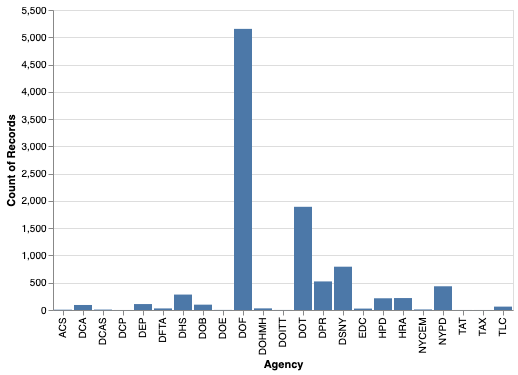


## Now try plotting data on a map

In [3]:
alt.Chart(df).mark_circle().encode(
    longitude='Longitude',
    latitude='Latitude',
    size='count()',
    color='count()',
    tooltip=['Agency', 'Complaint Type', 'Descriptor', 'Location Type', 'Incident Zip', 'City', 'Borough']
).project(
    type='albersUsa'
)

alt.Chart(...)

## In 30-50 lines of python code we are already doing data thinking at city-scale, analyzing 1M rows of data -- 311 calls to New York City, and visualizing it on a map to understand patterns and draw conclusions and maybe even help the city make decisions